# Sensitivity Analysis

There are 19 uncertainty parameters plus a policy involved in determining the outcome of interests above. By identifying the role and level of influence of each parameter to the outcome of interest, one might be able to acknowledge the potential and limitation of this model, hence the policies being recommended.

Feature scoring with extra trees is used to analyse the sensitivity. It is preferred because it allows more scenarios generated per each policy with lighter computational requirements and less time-consumption


In [1]:
import os
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import time

from ema_workbench import (SequentialEvaluator, Model, RealParameter,  
                           ScalarOutcome, ema_logging, MultiprocessingEvaluator,
                           perform_experiments, Policy)
from ema_workbench.analysis import cart, prim, dimensional_stacking, feature_scoring, RuleInductionType
ema_logging.log_to_stderr(ema_logging.DEBUG);


In [2]:
#FUNCTIONS FOR AGGREGATING AND DISAGGREGATING THE OOIS
def aggregate_outcomesA4(results, outcome):
    '''
    Aggregating the outcomes related to Gorssel (A.4)
    
    Parameters
    ----------
    results : dataframe
              the data from which the outcomes will be aggregated 
              and the result of aggregation will be appended on
    outcome : str
              the word(s) that characterize the outcome
              we want to aggregate, and the word(s) that will 
              be used as the name of the aggregate outcome 
              
    Return
    ----------
    results : dataframe
              the data from with appended aggregation result in the 
              last column
    '''
    a4 = "A.4"
    list_outcomes_columns = []

    for i in results.columns:
        if a4 in i:
            if outcome in i:
                list_outcomes_columns.append(i)

    results["Total A.4 " + str(outcome)
            ] = results[list_outcomes_columns].sum(axis=1)

def aggregate_outcomes(results, outcome):
    '''
    Aggregating the outcomes regardless the location of the dike
    
    Parameters
    ----------
    results : dataframe
              the data from which the outcomes will be aggregated 
              and the result of aggregation will be appended on
    outcome : str
              the word(s) that characterize the outcome
              we want to aggregate, and the word(s) that will 
              be used as the name of the aggregate outcome 
    
    Return
    ----------
    results : dataframe
              the data from with appended aggregation result in the 
              last column
    '''
    list_outcomes_columns = []

    for i in results.columns:
          if outcome in i:
                list_outcomes_columns.append(i)

    results["Total " + str(outcome)
            ] = results[list_outcomes_columns].sum(axis=1)
    
def aggregatendisaggregate_outcomes(results, outcome):
    list_outcomes_columns = []
    '''
    Aggregating the outcome regardless the dike location over 
    planning steps, then equally divide with 5 (number of dike rings).
    Particularly used to calculate Room for River or Evacuation costs 
    to be carried out by Gorssel.
    
    Parameters
    ----------
    results : dataframe
              the data from which the outcomes will be aggregated 
              and the result of aggregation will be appended on
    outcome : str
              the word(s) that characterize the outcome
              we want to aggregate, and the word(s) that will 
              be used as the name of the aggregate outcome 
    
    Return
    ----------
    results : dataframe
              the data from with appended aggregation result in the 
              last column
    '''
    for i in results.columns:
          if outcome in i:
                list_outcomes_columns.append(i)

    results["Total A.4" + str(outcome)
            ] = results[list_outcomes_columns].sum(axis=1)/5   


Loading the model with problem formulation 5.

In [3]:
from dike_model_function import DikeNetwork  # @UnresolvedImport

In [4]:
from ema_workbench import (Model, MultiprocessingEvaluator, Policy, Scenario,
                           ema_logging, perform_experiments, SequentialEvaluator)
from ema_workbench.em_framework.samplers import sample_uncertainties

import time
from problem_formulation import get_model_for_problem_formulation


ema_logging.log_to_stderr(ema_logging.INFO)

#choose problem formulation number, between 0-5
#each problem formulation has its own list of outcomes
dike_model, planning_steps = get_model_for_problem_formulation(5)

Enlisting the outcomes, uncertainties and levers provided by the model.

In [5]:
#enlisting outcomes
for outcome in dike_model.outcomes:
    print(repr(outcome))

ScalarOutcome('A.1_Expected Annual Damage 0')
ScalarOutcome('A.1_Dike Investment Costs 0')
ScalarOutcome('A.1_Expected Number of Deaths 0')
ScalarOutcome('A.2_Expected Annual Damage 0')
ScalarOutcome('A.2_Dike Investment Costs 0')
ScalarOutcome('A.2_Expected Number of Deaths 0')
ScalarOutcome('A.3_Expected Annual Damage 0')
ScalarOutcome('A.3_Dike Investment Costs 0')
ScalarOutcome('A.3_Expected Number of Deaths 0')
ScalarOutcome('A.4_Expected Annual Damage 0')
ScalarOutcome('A.4_Dike Investment Costs 0')
ScalarOutcome('A.4_Expected Number of Deaths 0')
ScalarOutcome('A.5_Expected Annual Damage 0')
ScalarOutcome('A.5_Dike Investment Costs 0')
ScalarOutcome('A.5_Expected Number of Deaths 0')
ScalarOutcome('RfR Total Costs 0')
ScalarOutcome('Expected Evacuation Costs 0')
ScalarOutcome('A.1_Expected Annual Damage 1')
ScalarOutcome('A.1_Dike Investment Costs 1')
ScalarOutcome('A.1_Expected Number of Deaths 1')
ScalarOutcome('A.2_Expected Annual Damage 1')
ScalarOutcome('A.2_Dike Investment

In [6]:
for unc in dike_model.uncertainties:
    print(repr(unc))
    
uncertainties = dike_model.uncertainties

import copy
uncertainties = copy.deepcopy(dike_model.uncertainties)

CategoricalParameter('discount rate 0', [0, 1, 2, 3])
CategoricalParameter('discount rate 1', [0, 1, 2, 3])
CategoricalParameter('discount rate 2', [0, 1, 2, 3])
IntegerParameter('A.0_ID flood wave shape', 0, 132)
RealParameter('A.1_Bmax', 30, 350)
RealParameter('A.1_pfail', 0, 1)
CategoricalParameter('A.1_Brate', [0, 1, 2])
RealParameter('A.2_Bmax', 30, 350)
RealParameter('A.2_pfail', 0, 1)
CategoricalParameter('A.2_Brate', [0, 1, 2])
RealParameter('A.3_Bmax', 30, 350)
RealParameter('A.3_pfail', 0, 1)
CategoricalParameter('A.3_Brate', [0, 1, 2])
RealParameter('A.4_Bmax', 30, 350)
RealParameter('A.4_pfail', 0, 1)
CategoricalParameter('A.4_Brate', [0, 1, 2])
RealParameter('A.5_Bmax', 30, 350)
RealParameter('A.5_pfail', 0, 1)
CategoricalParameter('A.5_Brate', [0, 1, 2])


In [7]:
for policy in dike_model.levers:
    print(repr(policy))
    
levers = dike_model.levers 

import copy
levers = copy.deepcopy(dike_model.levers)

IntegerParameter('0_RfR 0', 0, 1)
IntegerParameter('0_RfR 1', 0, 1)
IntegerParameter('0_RfR 2', 0, 1)
IntegerParameter('1_RfR 0', 0, 1)
IntegerParameter('1_RfR 1', 0, 1)
IntegerParameter('1_RfR 2', 0, 1)
IntegerParameter('2_RfR 0', 0, 1)
IntegerParameter('2_RfR 1', 0, 1)
IntegerParameter('2_RfR 2', 0, 1)
IntegerParameter('3_RfR 0', 0, 1)
IntegerParameter('3_RfR 1', 0, 1)
IntegerParameter('3_RfR 2', 0, 1)
IntegerParameter('4_RfR 0', 0, 1)
IntegerParameter('4_RfR 1', 0, 1)
IntegerParameter('4_RfR 2', 0, 1)
IntegerParameter('EWS_DaysToThreat', 0, 4)
IntegerParameter('A.1_DikeIncrease 0', 0, 10)
IntegerParameter('A.1_DikeIncrease 1', 0, 10)
IntegerParameter('A.1_DikeIncrease 2', 0, 10)
IntegerParameter('A.2_DikeIncrease 0', 0, 10)
IntegerParameter('A.2_DikeIncrease 1', 0, 10)
IntegerParameter('A.2_DikeIncrease 2', 0, 10)
IntegerParameter('A.3_DikeIncrease 0', 0, 10)
IntegerParameter('A.3_DikeIncrease 1', 0, 10)
IntegerParameter('A.3_DikeIncrease 2', 0, 10)
IntegerParameter('A.4_DikeIncreas

Performing experiments with the model of 500 random scenarios and 30 random policies using Latin-Hypercube as the uncertainty-sampler.

In [9]:
start = time.time()

with MultiprocessingEvaluator(dike_model) as evaluator:
    sa_results = evaluator.perform_experiments(scenarios=500, policies=30,
                                               uncertainty_sampling='lhs')

experiments30, outcomes30 = sa_results

end = time.time()
print("time taken: {} seconds".format((end-start)))

[MainProcess/INFO] pool started
[MainProcess/INFO] performing 500 scenarios * 30 policies * 1 model(s) = 15000 experiments
[MainProcess/DEBUG] 1 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Ex

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Dama

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 15 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Dam

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 18 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Dea

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 29 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Dea

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 32 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Co

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 43 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Co

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 46 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Dam

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 57 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Dam

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 60 cases comp

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 71 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Dea

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 85 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Co

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 96 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Co

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 99 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Dea

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 110 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of De

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 113 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment C

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 124 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment C

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 127 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Da

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 138 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Da

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 141 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of De

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 152 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of De

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 155 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment C

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 166 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment C

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 169 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Da

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 180 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Da

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 183 cases com

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 194 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of De

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 208 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment C

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 219 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation C

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 222 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of De

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 233 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of De

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 236 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment C

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 247 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment C

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 250 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Da

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 261 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Da

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 264 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of De

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 275 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of De

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 278 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment C

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 289 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment C

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 292 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Da

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 303 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Da

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 306 cases com

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 317 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of De

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 331 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment C

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 342 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation C

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 345 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of De

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 356 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of De

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 359 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment C

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 370 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment C

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 373 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Da

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 384 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Da

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 387 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of De

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 398 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of De

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 401 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment C

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 412 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment C

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 415 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Da

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 426 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Da

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 429 cases com

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 440 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of De

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 454 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment C

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 465 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation C

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 468 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of De

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 479 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of De

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 482 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment C

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 493 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment C

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 496 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Da

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 507 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Da

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 510 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of De

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 521 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of De

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 524 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment C

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 535 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment C

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 538 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Da

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 549 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Da

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 552 cases com

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 563 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of De

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 577 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment C

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 588 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation C

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 591 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of De

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 602 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of De

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 605 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment C

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 616 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment C

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 619 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Da

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 630 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Da

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 633 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of De

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 644 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of De

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 647 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment C

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 658 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment C

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 661 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Da

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 672 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Da

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 675 cases com

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 686 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of De

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 700 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment C

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 711 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation C

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 714 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of De

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 725 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of De

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 728 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment C

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 739 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment C

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 742 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Da

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 753 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Da

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 756 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of De

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 767 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of De

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 770 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment C

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 781 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment C

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 784 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Da

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 795 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Da

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 798 cases com

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 809 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of De

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 823 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment C

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 834 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation C

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 837 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of De

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 848 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of De

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 851 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment C

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 862 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment C

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 865 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Da

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 876 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Da

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 879 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of De

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 890 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of De

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 893 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment C

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 904 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment C

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 907 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Da

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 918 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Da

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 921 cases com

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 932 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of De

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 946 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment C

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 957 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation C

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 960 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of De

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 971 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of De

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 974 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment C

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 985 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment C

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 988 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Da

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 999 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Da

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1002 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1013 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1016 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1027 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1041 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1052 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1055 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1066 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1069 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1080 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1083 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1094 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1108 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1119 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1122 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1133 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1136 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1147 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1150 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1161 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1175 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1186 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1189 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1200 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1203 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1214 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1217 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1228 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1242 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1253 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1256 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1267 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1270 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1281 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1284 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1295 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1309 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1320 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1323 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1334 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1337 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1348 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1351 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1362 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1376 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1387 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1390 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1401 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1404 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1415 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1418 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1429 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1443 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1454 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1457 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1468 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1471 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1482 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1485 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1496 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1510 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1521 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1524 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1535 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1538 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1549 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1552 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1563 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1577 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1588 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1591 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1602 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1605 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1616 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1619 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1630 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1644 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1655 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1658 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1669 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1672 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1683 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1686 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1697 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1711 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1722 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1725 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1736 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1739 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1750 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1753 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1764 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1778 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1789 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1792 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1803 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1806 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1817 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1820 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1831 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1845 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1856 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1859 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1870 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1873 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1884 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1887 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1898 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1912 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1923 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1926 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1937 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1940 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1951 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1954 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1965 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1979 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1990 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 1993 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2004 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2007 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2018 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2021 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2032 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2046 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2057 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2060 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2071 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2074 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2085 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2088 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2099 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2113 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2124 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2127 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2138 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2141 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2152 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2155 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2166 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2180 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2191 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2194 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2205 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2208 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2219 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2222 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2233 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2247 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2258 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2261 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2272 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2275 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2286 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2289 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2300 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2314 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2325 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2328 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2339 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2342 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2353 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2356 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2367 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2381 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2392 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2395 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2406 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2409 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2420 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2423 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2434 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2448 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2459 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2462 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2473 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2476 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2487 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2490 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2501 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2515 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2526 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2529 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2540 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2543 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2554 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2557 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2568 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2582 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2593 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2596 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2607 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2610 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2621 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2624 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2635 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2649 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2660 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2663 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2674 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2677 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2688 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2691 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2702 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2716 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2727 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2730 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2741 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2744 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2755 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2758 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2769 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2783 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2794 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2797 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2808 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2811 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2822 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2825 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2836 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2850 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2861 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2864 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2875 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2878 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2889 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2892 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2903 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2917 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2928 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2931 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2942 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2945 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2956 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2959 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2970 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2984 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2995 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 2998 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3009 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3012 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3023 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3026 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3037 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3051 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3062 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3065 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3076 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3079 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3090 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3093 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3104 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3118 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3129 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3132 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3143 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3146 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3157 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3160 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3171 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3185 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3196 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3199 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3210 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3213 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3224 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3227 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3238 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3252 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3263 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3266 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3277 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3280 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3291 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3294 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3305 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3319 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3330 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3333 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3344 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3347 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3358 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3361 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3372 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3386 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3397 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3400 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3411 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3414 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3425 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3428 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3439 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3453 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3464 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3467 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3478 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3481 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3492 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3495 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3506 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3520 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3531 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3534 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3545 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3548 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3559 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3562 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3573 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3587 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3598 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3601 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3612 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3615 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3626 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3629 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3640 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3654 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3665 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3668 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3679 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3682 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3693 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3696 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3707 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3721 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3732 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3735 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3746 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3749 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3760 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3763 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3774 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3788 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3799 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3802 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3813 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3816 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3827 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3830 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3841 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3855 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3866 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3869 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3880 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3883 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3894 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3897 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3908 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3922 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3933 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3936 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3947 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3950 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3961 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3964 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3975 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 3989 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4000 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4003 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4014 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4017 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4028 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4031 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4042 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4056 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4067 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4070 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4081 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4084 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4095 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4098 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4109 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4123 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4134 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4137 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4148 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4151 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4162 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4165 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4176 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4190 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4201 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4204 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4215 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4218 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4229 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4232 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4243 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4257 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4268 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4271 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4282 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4285 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4296 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4299 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4310 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4324 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4335 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4338 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4349 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4352 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4363 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4366 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4377 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4391 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4402 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4405 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4416 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4419 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4430 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4433 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4444 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4556 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4567 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4570 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4581 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4584 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4595 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4598 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4609 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4623 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4634 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4637 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4648 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4651 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4662 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4665 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4676 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4690 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4701 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4704 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4715 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4718 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4729 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4732 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4743 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4757 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4768 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4771 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4782 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4785 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4796 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4799 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4810 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4824 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4835 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4838 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4849 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4852 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4863 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4866 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4877 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4891 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4902 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4905 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4916 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4919 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4930 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4933 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4944 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4958 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4969 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4972 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4983 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4986 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 4997 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5000 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5011 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5025 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5036 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5039 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5050 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5053 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5064 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5067 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5078 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5092 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5103 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5106 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5117 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5120 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5131 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5134 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5145 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5159 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5170 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5173 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5184 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5187 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5198 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5201 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5212 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5226 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5237 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5240 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5251 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5254 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5265 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5268 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5279 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5293 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5304 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5307 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5318 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5321 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5332 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5335 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5346 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5360 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5371 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5374 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5385 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5388 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5399 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5402 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5413 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5427 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5438 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5441 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5452 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5455 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5466 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5469 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5480 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5494 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5505 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5508 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5519 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5522 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5533 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5536 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5547 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5561 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5572 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5575 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5586 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5589 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5600 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5603 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5614 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5628 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5639 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5642 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5653 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5656 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5667 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5670 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5681 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5695 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5706 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5709 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5720 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5723 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5734 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5737 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5748 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5762 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5773 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5776 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5787 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5790 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5801 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5804 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5815 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5829 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5840 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5843 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5854 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5857 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5868 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5871 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5882 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5896 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5907 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5910 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5921 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5924 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5935 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5938 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5949 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5963 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5974 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5977 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5988 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 5991 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6002 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment 

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6005 cases co

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6016 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of D

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6030 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6041 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6044 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6055 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6058 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6069 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6072 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6083 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6097 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6108 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6111 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6122 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6125 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6136 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6139 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6150 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6164 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6175 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6178 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6189 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6192 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6203 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6206 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6383 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of D

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6386 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6397 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6400 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6411 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6414 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6425 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6439 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6450 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6453 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6464 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6467 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6478 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6481 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6492 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6506 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6517 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6520 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6531 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6534 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6545 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6548 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6559 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6573 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6584 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6587 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6598 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6601 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6612 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6615 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6626 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6640 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6651 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6654 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6665 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6668 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6679 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6682 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6693 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6707 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6718 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6721 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6732 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6735 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6746 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6749 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6760 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6774 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6785 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6788 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6799 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6802 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6813 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6816 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6827 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6841 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6852 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6855 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6866 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6869 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6880 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6883 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6894 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6908 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6919 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6922 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6933 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6936 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6947 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6950 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6961 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6975 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6986 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 6989 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7000 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7003 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7014 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7017 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7028 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7042 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7053 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7056 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7067 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7070 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7081 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7084 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7095 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7109 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7120 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7123 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7134 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7137 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7148 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7151 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7162 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7176 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7187 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7190 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7201 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7204 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7215 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7218 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7229 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7243 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7254 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7257 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7268 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7271 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7282 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7285 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7296 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7310 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7321 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7324 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7335 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7338 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7349 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7352 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7363 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7377 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7388 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7391 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7402 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7405 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7416 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7419 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7430 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7444 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7455 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7458 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7469 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7472 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7483 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7486 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7497 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7511 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7522 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7525 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7536 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7539 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7550 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7553 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7564 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7578 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7589 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7592 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7603 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7606 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7617 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7620 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7631 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7645 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7656 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7659 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7670 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7673 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7684 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7687 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7698 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7712 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7723 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7726 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7737 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7740 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7751 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7754 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7765 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7779 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7790 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7793 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7804 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7807 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7818 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7821 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7832 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7846 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7857 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7860 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7871 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7874 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7885 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7888 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7899 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7913 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7924 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7927 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7938 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7941 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7952 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7955 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7966 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7980 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7991 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 7994 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8005 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8008 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8019 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8022 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8033 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8047 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8058 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8061 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8072 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8075 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8086 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8089 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8100 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8114 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8125 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8128 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8139 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8142 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8153 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8156 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8167 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8181 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8192 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8195 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8206 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8209 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8220 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8223 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8234 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8248 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8259 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8262 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8273 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8276 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8287 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8290 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8301 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8315 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8326 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8329 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8340 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8343 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8354 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8357 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8368 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8382 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8393 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8396 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8407 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8410 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8421 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8424 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8435 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8449 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8460 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8463 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8474 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8477 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8488 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8491 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8502 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8516 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8527 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8530 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8541 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8544 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8555 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8558 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8569 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8583 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8594 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8597 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8608 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8611 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8622 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8625 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8636 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8650 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8661 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8664 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8675 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8678 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8689 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8692 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8703 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8717 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8728 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8731 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8742 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8745 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8756 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8759 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8770 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8784 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8795 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8798 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8809 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8812 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8823 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8826 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8837 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8851 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8862 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8865 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8876 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8879 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8890 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8893 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8904 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8918 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8929 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8932 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8943 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8946 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8957 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8960 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8971 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8985 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8996 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 8999 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9010 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9013 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9024 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9027 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9038 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9052 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9063 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9066 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9077 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9080 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9091 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9094 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9105 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9119 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9217 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9220 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9231 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9234 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9245 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9259 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9270 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9273 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9284 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9287 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9298 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9301 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9312 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 9520 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation 

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9523 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of D

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9534 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of D

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9537 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9548 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9551 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9562 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9565 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9576 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9590 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9601 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9604 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9615 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9618 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9629 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9632 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9643 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9941 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of D

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9955 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9966 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total 

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9969 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9980 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual D

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9983 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of D

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9994 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 9997 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment 

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10008 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10414 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 10425 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10428 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of 

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10439 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10442 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of 

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10453 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10456 cases c

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10467 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10478 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10481 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10492 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10495 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10506 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 10517 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10520 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of 

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10531 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10534 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of 

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10545 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10548 cases c

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10559 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10570 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10573 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10756 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10767 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10770 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10781 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10784 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10795 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10809 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10820 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10823 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10834 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of 

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10837 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual 

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10848 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 10859 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10862 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of 

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10873 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10876 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of 

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10887 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10890 cases c

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10901 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10912 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10915 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10926 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10929 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10940 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10954 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10965 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10968 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10979 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of 

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10982 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual 

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 10993 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 11004 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11007 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of 

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11018 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11021 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of 

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11032 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11035 cases c

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11046 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11057 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11060 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11071 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11074 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11085 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11099 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11226 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11237 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11240 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11251 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of 

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11254 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual 

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11265 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 11276 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11279 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of 

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11290 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11293 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of 

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11304 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11307 cases c

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11318 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11329 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11332 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11343 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11346 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11357 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11371 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11382 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11385 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11396 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of 

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11399 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual 

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11410 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 11421 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11424 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of 

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11435 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11438 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of 

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11449 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11452 cases c

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11463 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11474 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11477 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11488 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11491 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11502 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11516 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11527 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11530 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11541 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of 

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11544 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual 

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11555 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 11566 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11569 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of 

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11580 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11583 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of 

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11594 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11597 cases c

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11608 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11619 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11622 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11633 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11636 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11647 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11661 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11672 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11675 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11686 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of 

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11689 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual 

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11700 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 11711 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11714 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of 

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11725 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11728 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of 

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11739 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11742 cases c

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11753 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11764 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11767 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11778 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11781 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11792 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11806 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11817 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11820 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11831 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of 

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11834 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual 

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11845 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 11856 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11859 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of 

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11870 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11873 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of 

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11884 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11887 cases c

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11898 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11909 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11912 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11923 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11926 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11937 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11951 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11962 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11965 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11976 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of 

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11979 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual 

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 11990 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12001 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12004 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12015 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12018 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12029 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12043 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12054 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12057 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12068 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of 

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12071 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual 

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12082 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 12093 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12096 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of 

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12107 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12110 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of 

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12121 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12124 cases c

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12135 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12146 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12149 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12160 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12163 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12174 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12188 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12199 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12202 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12213 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of 

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12216 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual 

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12227 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 12238 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12241 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of 

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12252 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12255 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of 

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12266 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12269 cases c

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12280 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12291 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12294 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12305 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12308 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12319 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12333 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12344 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12347 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12358 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of 

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12361 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual 

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12372 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 12383 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12386 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of 

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12397 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12400 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of 

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12411 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12414 cases c

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12425 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12436 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12439 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12450 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12453 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12464 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12478 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12489 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12492 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12503 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of 

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12506 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual 

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12517 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 12528 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12531 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of 

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12542 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12545 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of 

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12556 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12559 cases c

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12570 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12581 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12584 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12595 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12598 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12609 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12623 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12634 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12637 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12648 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of 

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12651 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual 

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12662 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 12673 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12676 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of 

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12687 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12690 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of 

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12701 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12704 cases c

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12715 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12726 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12729 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12740 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12743 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12754 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12768 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12779 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12782 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12793 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of 

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12796 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual 

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12807 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 12818 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12821 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of 

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12832 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12835 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of 

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12846 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12849 cases c

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12860 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12871 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12874 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12885 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12888 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12899 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12913 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12924 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12927 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12938 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of 

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12941 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual 

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12952 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 12963 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12966 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of 

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12977 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12980 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of 

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12991 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 12994 cases c

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13005 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13016 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13019 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13030 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13033 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13044 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13058 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13069 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13072 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13083 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of 

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13086 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual 

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13097 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 13108 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13111 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of 

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13122 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13125 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of 

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13136 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13139 cases c

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13150 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13161 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13164 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13175 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13178 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13189 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13203 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13214 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13217 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13228 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of 

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13231 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual 

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13242 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 13253 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13256 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of 

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13267 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13270 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of 

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13281 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13284 cases c

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13295 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13306 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13309 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13320 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13323 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13334 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13348 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13359 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13362 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13373 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of 

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13376 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual 

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13387 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 13398 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13401 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of 

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13412 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13415 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of 

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13426 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13429 cases c

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13440 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13451 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13454 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13465 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13468 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13479 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13493 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13504 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13507 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of 

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13518 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13521 cases c

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13532 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13543 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13546 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13557 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13560 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13571 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13585 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13596 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13599 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13610 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of 

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13613 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual 

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13624 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 13635 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13638 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of 

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13649 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13652 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of 

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13663 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13666 cases c

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13677 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13688 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13691 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13702 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13705 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13716 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13730 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13741 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13744 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13755 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of 

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13758 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual 

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13769 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 13780 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13783 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of 

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13794 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13797 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of 

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13808 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13811 cases c

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13822 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13833 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13836 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13847 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13850 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13861 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13875 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13886 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13889 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13900 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of 

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13903 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual 

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13914 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 13925 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13928 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of 

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13939 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13942 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of 

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13953 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13956 cases c

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13967 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13978 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13981 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13992 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 13995 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14006 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14020 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14031 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14034 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14045 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of 

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14048 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual 

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14059 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 14070 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14073 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of 

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14084 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14087 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of 

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14098 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14101 cases c

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14112 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14123 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14126 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14137 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14140 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14151 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14165 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14176 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14179 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14190 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of 

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14193 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual 

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14204 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 14215 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14218 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of 

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14229 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14232 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of 

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14243 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14246 cases c

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14257 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14268 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14271 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14282 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14285 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14296 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14310 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14321 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14324 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14335 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of 

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14338 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual 

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14349 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 14360 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14363 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of 

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14374 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14377 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of 

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14388 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14391 cases c

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14402 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14413 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14416 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14427 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14430 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14441 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14455 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14466 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14469 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14480 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of 

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14483 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual 

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14494 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] 14505 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14508 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of 

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14519 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14522 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of 

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_D

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14533 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14536 cases c

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_D

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14547 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14558 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14561 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14572 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14575 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14586 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14600 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14611 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14614 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14625 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of 

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14628 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual 

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14742 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14745 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14756 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14759 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14770 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14784 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14795 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14798 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14809 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of 

[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14812 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual 

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_D

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14823 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of 

[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR T

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14949 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual 

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14952 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_E

[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14963 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual 

[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_E

[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_E

[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14977 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual 

[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_D

[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_E

[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_E

[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14988 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of 

[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 2
[MainProcess/DEBUG] storing RfR Total Costs 2
[MainProcess/DEBUG] storing Expected Evacuation Costs 2
[MainProcess/DEBUG] 14991 cases completed
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.2_Expected Annual 

[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expected Evacuation Costs 1
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 2
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 2
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 2
[MainProcess/DEBUG] storing A.4_D

[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 1
[MainProcess/DEBUG] storing RfR Total Costs 1
[MainProcess/DEBUG] storing Expec

[MainProcess/DEBUG] storing A.2_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.3_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.3_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.3_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.4_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.4_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.4_Expected Number of Deaths 0
[MainProcess/DEBUG] storing A.5_Expected Annual Damage 0
[MainProcess/DEBUG] storing A.5_Dike Investment Costs 0
[MainProcess/DEBUG] storing A.5_Expected Number of Deaths 0
[MainProcess/DEBUG] storing RfR Total Costs 0
[MainProcess/DEBUG] storing Expected Evacuation Costs 0
[MainProcess/DEBUG] storing A.1_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.1_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.1_Expected Number of Deaths 1
[MainProcess/DEBUG] storing A.2_Expected Annual Damage 1
[MainProcess/DEBUG] storing A.2_Dike Investment Costs 1
[MainProcess/DEBUG] storing A.2_E

Aggregating the outcome of interest, since we are not interested in the outcomes of regions other than Gorssel and not interested in outcomes per time step.

In [10]:
outcomes30_ = pd.DataFrame(outcomes30)
aggregate_outcomesA4(outcomes30_, "Expected Annual Damage")
aggregate_outcomesA4(outcomes30_, "Expected Number of Deaths")
aggregate_outcomesA4(outcomes30_, "Dike Investment Costs")
aggregate_outcomes(outcomes30_, "RfR Total Costs")
aggregate_outcomes(outcomes30_, "Expected Evacuation Costs")
outcomes30_

,A.1_Expected Annual Damage 0,A.1_Dike Investment Costs 0,A.1_Expected Number of Deaths 0,A.2_Expected Annual Damage 0,A.2_Dike Investment Costs 0,A.2_Expected Number of Deaths 0,A.3_Expected Annual Damage 0,A.3_Dike Investment Costs 0,A.3_Expected Number of Deaths 0,A.4_Expected Annual Damage 0,...,A.5_Expected Annual Damage 2,A.5_Dike Investment Costs 2,A.5_Expected Number of Deaths 2,RfR Total Costs 2,Expected Evacuation Costs 2,Total A.4 Expected Annual Damage,Total A.4 Expected Number of Deaths,Total A.4 Dike Investment Costs,Total RfR Total Costs,Total Expected Evacuation Costs
0,0.0,6.813900e+07,0.0,0.0,8.127741e+07,0.0,0.000000e+00,3.139880e+07,0.000000,0.000000e+00,...,0.0,5.269381e+07,0.0,151900000.0,0.0,0.000000e+00,0.000000,4.781190e+07,6.428000e+08,0.000000
1,0.0,6.813900e+07,0.0,0.0,8.127741e+07,0.0,0.000000e+00,3.139880e+07,0.000000,1.154089e+06,...,0.0,5.269381e+07,0.0,151900000.0,0.0,1.154089e+06,0.000071,4.781190e+07,6.428000e+08,77.025229
2,0.0,6.813900e+07,0.0,0.0,8.127741e+07,0.0,0.000000e+00,3.139880e+07,0.000000,0.000000e+00,...,0.0,5.269381e+07,0.0,151900000.0,0.0,0.000000e+00,0.000000,4.781190e+07,6.428000e+08,0.000000
3,0.0,6.813900e+07,0.0,0.0,8.127741e+07,0.0,0.000000e+00,3.139880e+07,0.000000,0.000000e+00,...,0.0,5.269381e+07,0.0,151900000.0,0.0,0.000000e+00,0.000000,4.781190e+07,6.428000e+08,0.000000
4,0.0,6.813900e+07,0.0,0.0,8.127741e+07,0.0,0.000000e+00,3.139880e+07,0.000000,0.000000e+00,...,0.0,5.269381e+07,0.0,151900000.0,0.0,0.000000e+00,0.000000,4.781190e+07,6.428000e+08,102.024411
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14995,0.0,3.725520e+07,0.0,0.0,6.604510e+07,0.0,0.000000e+00,2.029929e+07,0.000000,1.493614e+06,...,0.0,0.000000e+00,0.0,710400000.0,0.0,3.925272e+06,0.000253,1.426165e+07,2.015900e+09,219.464123
14996,0.0,3.725520e+07,0.0,0.0,6.604510e+07,0.0,1.800109e+06,2.029929e+07,0.000362,0.000000e+00,...,0.0,0.000000e+00,0.0,710400000.0,0.0,0.000000e+00,0.000000,1.426165e+07,2.015900e+09,48.529522
14997,0.0,3.725520e+07,0.0,0.0,6.604510e+07,0.0,9.045959e+05,2.029929e+07,0.000360,0.000000e+00,...,0.0,0.000000e+00,0.0,710400000.0,0.0,1.471053e+05,0.000013,1.426165e+07,2.015900e+09,58.857896
14998,0.0,3.725520e+07,0.0,0.0,6.604510e+07,0.0,7.964363e+06,2.029929e+07,0.002057,2.434912e+06,...,0.0,0.000000e+00,0.0,710400000.0,0.0,4.467430e+06,0.000325,1.426165e+07,2.015900e+09,626.282299


Selecting only the outcomes of interest.

In [11]:
outcomes30_ = outcomes30_.iloc[:,51:55]

In [12]:
#experiments30.to_csv('experiments30.csv')
#outcomes30_.to_csv('outcomes30_.csv')

In [18]:
#Start here if you do not wat to re run the Multiprocesssingevaluator
#experiments30 = pd.read_csv('experiments30.csv', index_col=0)
#outcomes30_ =  pd.read_csv('outcomes30_.csv', index_col=0)

In [19]:
outcomes30_

,Total A.4 Expected Annual Damage,Total A.4 Expected Number of Deaths,Total A.4 Dike Investment Costs,Total RfR Total Costs
0,0.000000e+00,0.000000,4.781190e+07,6.428000e+08
1,1.154089e+06,0.000071,4.781190e+07,6.428000e+08
2,0.000000e+00,0.000000,4.781190e+07,6.428000e+08
3,0.000000e+00,0.000000,4.781190e+07,6.428000e+08
4,0.000000e+00,0.000000,4.781190e+07,6.428000e+08
...,...,...,...,...
14995,3.925272e+06,0.000253,1.426165e+07,2.015900e+09
14996,0.000000e+00,0.000000,1.426165e+07,2.015900e+09
14997,1.471053e+05,0.000013,1.426165e+07,2.015900e+09
14998,4.467430e+06,0.000325,1.426165e+07,2.015900e+09


In [13]:
experiments30

,Unnamed: 0,A.0_ID flood wave shape,A.1_Bmax,A.1_Brate,A.1_pfail,A.2_Bmax,A.2_Brate,A.2_pfail,A.3_Bmax,A.3_Brate,...,A.4_DikeIncrease 0,A.4_DikeIncrease 1,A.4_DikeIncrease 2,A.5_DikeIncrease 0,A.5_DikeIncrease 1,A.5_DikeIncrease 2,EWS_DaysToThreat,scenario,policy,model
0,0,118.0,147.564638,1.0,0.590765,125.399011,1.5,0.081121,283.098825,1.5,...,9.0,2.0,1.0,10.0,9.0,5.0,0.0,1000,0,dikesnet
1,1,32.0,178.507488,10.0,0.094803,339.637355,1.0,0.424109,323.351383,1.5,...,9.0,2.0,1.0,10.0,9.0,5.0,0.0,1001,0,dikesnet
2,2,34.0,185.778689,1.0,0.518037,183.819147,1.5,0.413875,186.595323,1.5,...,9.0,2.0,1.0,10.0,9.0,5.0,0.0,1002,0,dikesnet
3,3,23.0,209.328218,10.0,0.115717,291.253783,1.0,0.758163,200.997673,1.0,...,9.0,2.0,1.0,10.0,9.0,5.0,0.0,1003,0,dikesnet
4,4,55.0,229.428464,10.0,0.753428,259.425799,1.5,0.287525,87.412228,1.0,...,9.0,2.0,1.0,10.0,9.0,5.0,0.0,1004,0,dikesnet
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14995,14995,91.0,103.953622,1.5,0.544580,239.169755,1.5,0.922340,269.831242,10.0,...,10.0,9.0,9.0,4.0,6.0,10.0,1.0,1495,29,dikesnet
14996,14996,21.0,43.443558,10.0,0.129839,177.044392,1.5,0.268977,56.957611,1.0,...,10.0,9.0,9.0,4.0,6.0,10.0,1.0,1496,29,dikesnet
14997,14997,3.0,340.045460,1.0,0.068115,34.821399,1.0,0.472644,147.624374,1.0,...,10.0,9.0,9.0,4.0,6.0,10.0,1.0,1497,29,dikesnet
14998,14998,130.0,96.160775,1.0,0.120890,161.938417,1.0,0.523130,337.037274,10.0,...,10.0,9.0,9.0,4.0,6.0,10.0,1.0,1498,29,dikesnet


### Visualizing the outcomes of interest

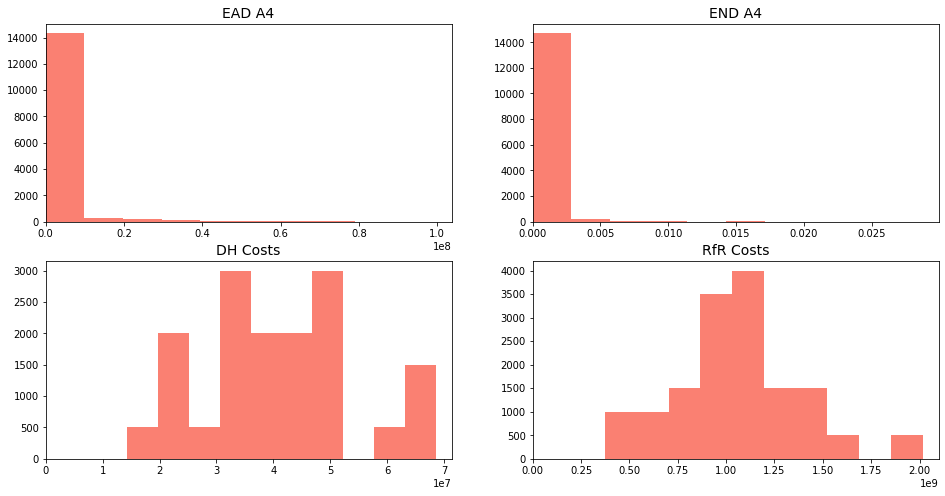

In [49]:
import seaborn as sns
import matplotlib.pyplot as plt
fig, axes = plt.subplots(2,2, figsize=(16,8))

axes[0,0].set_title('EAD A4', size=14)
axes[0,1].set_title('END A4', size=14)
axes[1,0].set_title('DH Costs', size=14)
axes[1,1].set_title('RfR Costs', size=14)

axes[0,0].hist(outcomes30_['Total A.4 Expected Annual Damage'], color="salmon")
axes[0,0].set_xlim(left=0)
axes[0,1].hist(outcomes30_['Total A.4 Expected Number of Deaths'], color="salmon")
axes[0,1].set_xlim(left=0)
axes[1,0].hist(outcomes30_['Total A.4 Dike Investment Costs'], color="salmon")
axes[1,0].set_xlim(left=0)
axes[1,1].hist(outcomes30_['Total RfR Total Costs'], color="salmon")
axes[1,1].set_xlim(left=0)
#sns.kdeplot(outcomes30_['Total A.4 Expected Annual Damage'], ax=axes[0,0], shade=True, legend = False)
#sns.kdeplot(outcomes30_['Total A.4 Expected Number of Deaths'], ax=axes[0,1], shade=True, legend = False)
#sns.kdeplot(outcomes30_['Total A.4 Dike Investment Costs'], ax=axes[1,0], shade=True, legend = False)
#sns.kdeplot(outcomes30_['Total RfR Total Costs'], ax=axes[1,1], shade=True, legend = False)

plt.show()

From the two histograms above, we can conclude that the likelihood of the flood happen in Gorssel is not so high. Majority of the random scenarios resulted in zero Expected Annual Damage (EAD) and zero Expected Number of Deaths (END). Of the total 15000 experiments, above 14000 are zero EAD and END. However, these good END and EAD were also achieved with support of flood protection policies, which are costly.

Next, we do sensitivity analysis of the situation to see which parameters influence the outcomes of interest the most. The outcomes of interest are:
1. Total A.4 Expected Annual Damage	
2. Total A.4 Expected Number of Deaths	
3. Total A.4 Dike Investment Costs	
4. Total RfR Total Costs (total accummulation, before shared to all regions)

Total evacuation costs are usually very minor compared to the other two costs, so it is not observed for the Sensitivity Analysis.

In [20]:
factors30 = experiments30.loc[:, ["discount rate 0","discount rate 1","discount rate 2",
                                  "A.0_ID flood wave shape", "A.1_Bmax", "A.1_pfail", "A.1_Brate",
                                  "A.2_Bmax", "A.2_pfail", "A.2_Brate",
                                  "A.3_Bmax", "A.3_pfail", "A.3_Brate",
                                  "A.4_Bmax", "A.4_pfail", "A.4_Brate",
                                  "A.5_Bmax", "A.5_pfail", "A.5_Brate", "policy"]]

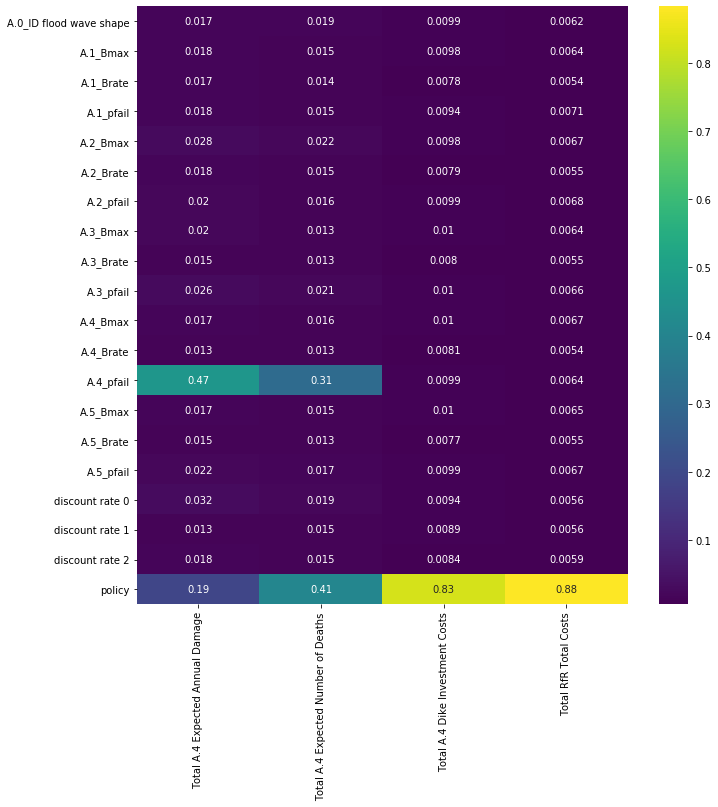

In [21]:
x = factors30
y = outcomes30_

#generating feature-score for all policies and all outcomes of interest
fig, ax = plt.subplots(figsize=(11,11))
fs = feature_scoring.get_feature_scores_all(x, y)
sns.heatmap(ax=ax, data=fs, cmap='viridis', annot=True)
plt.show()

To enhance the accuracy of the sensitivity analysis of feature scoring with LHS sampling, we ran extra trees on a binary vector for Total A.4 Expected Annual Damage and Total A.4 Expected Number of Deaths. The extra trees will classify the Total A.4 Expected Annual Damage and Total A.4 Expected Number of Deaths based on their average value in No-Policy scenarios (data derived from Open Exploration_Base Case_PF5).

#### Identifying the average value of EAD A4 and END A4 in No-Policy scenarios:

In [32]:
from ema_workbench.util import utilities 

basecase = utilities.load_results('BaseCase_1000_PF5')
expbasecase, outcomesbasecase = basecase
outcomesbasecase = pd.DataFrame(outcomesbasecase)
outcomesbasecase

[MainProcess/INFO] results loaded succesfully from C:\Users\VANNESYA\Documents\Study\Q4\EPA1361\final assignment\BaseCase_1000_PF5


,A.1_Expected Annual Damage 0,A.1_Dike Investment Costs 0,A.1_Expected Number of Deaths 0,A.2_Expected Annual Damage 0,A.2_Dike Investment Costs 0,A.2_Expected Number of Deaths 0,A.3_Expected Annual Damage 0,A.3_Dike Investment Costs 0,A.3_Expected Number of Deaths 0,A.4_Expected Annual Damage 0,...,A.3_Dike Investment Costs 3,A.3_Expected Number of Deaths 3,A.4_Expected Annual Damage 3,A.4_Dike Investment Costs 3,A.4_Expected Number of Deaths 3,A.5_Expected Annual Damage 3,A.5_Dike Investment Costs 3,A.5_Expected Number of Deaths 3,RfR Total Costs 3,Expected Evacuation Costs 3
0,6.833754e+06,0,0.009442,3.519336e+06,0,0.006609,3.572068e+08,0,1.146792,0.000000e+00,...,0,1.146792,0.000000e+00,0,0.000000,0.000000e+00,0,0.000000,0.0,0.0
1,0.000000e+00,0,0.000000,1.949421e+08,0,0.281870,5.517566e+07,0,0.157227,0.000000e+00,...,0,0.157227,0.000000e+00,0,0.000000,0.000000e+00,0,0.000000,0.0,0.0
2,1.629577e+07,0,0.017554,1.569261e+07,0,0.022348,3.876383e+06,0,0.010514,1.651674e+07,...,0,0.010514,1.895164e+07,0,0.011292,0.000000e+00,0,0.000000,0.0,0.0
3,0.000000e+00,0,0.000000,6.378880e+06,0,0.011883,1.675471e+07,0,0.058224,1.824028e+07,...,0,0.058224,2.059539e+07,0,0.015772,0.000000e+00,0,0.000000,0.0,0.0
4,1.761271e+08,0,0.202266,0.000000e+00,0,0.000000,0.000000e+00,0,0.000000,0.000000e+00,...,0,0.000000,0.000000e+00,0,0.000000,1.408909e+07,0,0.023467,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,5.668782e+07,0,0.051635,2.063669e+08,0,0.228675,1.990092e+08,0,0.432029,0.000000e+00,...,0,0.432029,0.000000e+00,0,0.000000,0.000000e+00,0,0.000000,0.0,0.0
996,2.041735e+08,0,0.206898,1.576028e+06,0,0.002257,0.000000e+00,0,0.000000,1.180295e+06,...,0,0.000000,1.354294e+06,0,0.000915,0.000000e+00,0,0.000000,0.0,0.0
997,0.000000e+00,0,0.000000,1.967151e+08,0,0.285719,2.581311e+07,0,0.077666,0.000000e+00,...,0,0.077666,0.000000e+00,0,0.000000,9.465795e+05,0,0.001615,0.0,0.0
998,0.000000e+00,0,0.000000,4.569459e+06,0,0.006741,3.891234e+07,0,0.104186,3.758552e+07,...,0,0.104186,4.312638e+07,0,0.022791,0.000000e+00,0,0.000000,0.0,0.0


In [33]:
aggregate_outcomesA4(outcomesbasecase, "Expected Annual Damage")
aggregate_outcomesA4(outcomesbasecase, "Expected Number of Deaths")
outcomesbasecase

,A.1_Expected Annual Damage 0,A.1_Dike Investment Costs 0,A.1_Expected Number of Deaths 0,A.2_Expected Annual Damage 0,A.2_Dike Investment Costs 0,A.2_Expected Number of Deaths 0,A.3_Expected Annual Damage 0,A.3_Dike Investment Costs 0,A.3_Expected Number of Deaths 0,A.4_Expected Annual Damage 0,...,A.4_Expected Annual Damage 3,A.4_Dike Investment Costs 3,A.4_Expected Number of Deaths 3,A.5_Expected Annual Damage 3,A.5_Dike Investment Costs 3,A.5_Expected Number of Deaths 3,RfR Total Costs 3,Expected Evacuation Costs 3,Total A.4 Expected Annual Damage,Total A.4 Expected Number of Deaths
0,6.833754e+06,0,0.009442,3.519336e+06,0,0.006609,3.572068e+08,0,1.146792,0.000000e+00,...,0.000000e+00,0,0.000000,0.000000e+00,0,0.000000,0.0,0.0,0.000000e+00,0.000000
1,0.000000e+00,0,0.000000,1.949421e+08,0,0.281870,5.517566e+07,0,0.157227,0.000000e+00,...,0.000000e+00,0,0.000000,0.000000e+00,0,0.000000,0.0,0.0,0.000000e+00,0.000000
2,1.629577e+07,0,0.017554,1.569261e+07,0,0.022348,3.876383e+06,0,0.010514,1.651674e+07,...,1.895164e+07,0,0.011292,0.000000e+00,0,0.000000,0.0,0.0,6.649885e+07,0.045166
3,0.000000e+00,0,0.000000,6.378880e+06,0,0.011883,1.675471e+07,0,0.058224,1.824028e+07,...,2.059539e+07,0,0.015772,0.000000e+00,0,0.000000,0.0,0.0,8.916630e+07,0.063089
4,1.761271e+08,0,0.202266,0.000000e+00,0,0.000000,0.000000e+00,0,0.000000,0.000000e+00,...,0.000000e+00,0,0.000000,1.408909e+07,0,0.023467,0.0,0.0,0.000000e+00,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,5.668782e+07,0,0.051635,2.063669e+08,0,0.228675,1.990092e+08,0,0.432029,0.000000e+00,...,0.000000e+00,0,0.000000,0.000000e+00,0,0.000000,0.0,0.0,0.000000e+00,0.000000
996,2.041735e+08,0,0.206898,1.576028e+06,0,0.002257,0.000000e+00,0,0.000000,1.180295e+06,...,1.354294e+06,0,0.000915,0.000000e+00,0,0.000000,0.0,0.0,4.926043e+06,0.003660
997,0.000000e+00,0,0.000000,1.967151e+08,0,0.285719,2.581311e+07,0,0.077666,0.000000e+00,...,0.000000e+00,0,0.000000,9.465795e+05,0,0.001615,0.0,0.0,0.000000e+00,0.000000
998,0.000000e+00,0,0.000000,4.569459e+06,0,0.006741,3.891234e+07,0,0.104186,3.758552e+07,...,4.312638e+07,0,0.022791,0.000000e+00,0,0.000000,0.0,0.0,1.475482e+08,0.091162


In [35]:
meanEAD = outcomesbasecase['Total A.4 Expected Annual Damage'].mean()
meanEND = outcomesbasecase['Total A.4 Expected Number of Deaths'].mean()

#### Applying extra trees

In [52]:
print('Extra Tree Feature Score on EAD')
EAD = outcomes30_['Total A.4 Expected Annual Damage']<meanEAD
fs, alg = feature_scoring.get_ex_feature_scores(x, EAD, mode=RuleInductionType.CLASSIFICATION)
fs.sort_values(ascending=False, by=1)

Extra Tree Feature Score on EAD


,1
0,
A.4_pfail,0.428188
policy,0.200088
discount rate 0,0.033413
A.2_Bmax,0.026864
A.5_pfail,0.025948
A.3_pfail,0.024368
A.2_pfail,0.022895
A.0_ID flood wave shape,0.021084
A.5_Bmax,0.021042


In [54]:
fs.to_csv('ETFS EAD.csv')

In [55]:
print('Extra Tree Feature Score on Casualty')
END = outcomes30_['Total A.4 Expected Number of Deaths']<meanEND
fs, alg = feature_scoring.get_ex_feature_scores(x, END, mode=RuleInductionType.CLASSIFICATION)
fs.sort_values(ascending=False, by=1)

Extra Tree Feature Score on Casualty


,1
0,
policy,0.422575
A.4_pfail,0.179427
A.3_Bmax,0.030038
A.2_Bmax,0.026401
A.5_pfail,0.026264
A.4_Bmax,0.025603
A.1_Bmax,0.025005
A.1_pfail,0.023410
A.2_pfail,0.022804


In [56]:
fs.to_csv('ETFS END.csv')

From extra trees feature scoring, we identified that the outcome Total A.4 Expected Number of Deaths is mostly influenced by the policy and then the A.4_pfail, other variables are insignificant. The outcome Total A.4 Expected Annual Damage is mostly driven by A.4_pfail and then the policy, other variables are insignificant. The outcomes Total A.4 Dike Investment Costs and Total RfR Total Costs are largely driven by the policy.